In [1]:
path = 'filtered_pile_metrics_all'

In [2]:
import ast
import json
import cattrs
import pandas as pd
from nltk import ngrams
from collections import defaultdict
from typing import List, Tuple
from dataclasses import dataclass

from data_overlap_spec import DataOverlapStats, DataOverlapStatsKey, EntryOverlapNgrams
from compute_data_overlap_metrics import load_light_scenarios_from_jsonl
from common.util import get_tokenizer
from common.general import asdict_without_nones

from enum import Enum
%matplotlib inline



In [3]:
@dataclass(frozen=True)
class EntryDataOverlapKey:
    """Unique key representing either the input or references of a single instance in a scenario."""

    stats_key: DataOverlapStatsKey
    part: str
    """Either PART_INPUT or PART_REF"""
    instance_id: str


# Input: List[EntryOverlapNgrams]
@dataclass(frozen=True)
class EntryOverlapNgrams:
    """Dataclass that represents output data overlap stats"""

    entry_data_overlap_key: EntryDataOverlapKey

    overlapping_ngram_counts: List[Tuple[str, int]]


class PartialOverlapSpec(int, Enum):
    binary = 0
    jaccard = 1
    token = 2

@dataclass(frozen=True)
class FrequencySpec:
    # Filter ngrams with frequency >= filter_value; 0 means no filter
    filter_value: int
    # Whether to apply weight; we'll do inverse frequency
    weighting: bool
        
@dataclass(frozen=True)
class MetricProtocolSpec:
    """Specification for how we compute the metric"""
    
    partial_overlap_spec: PartialOverlapSpec
    frequency_spec: FrequencySpec
        
@dataclass(frozen=True)
class OverlapMetric:
    metric_score: float # use 0/1 for binary, can revise as neded
    metric_protocol_spec: MetricProtocolSpec

# Output: List[EntryOverlapMetric]
@dataclass(frozen=True)
class EntryOverlapMetric:
    """Dataclass that represents output data overlap stats"""

    entry_data_overlap_key: EntryDataOverlapKey

    overlap_metric: OverlapMetric
        
        

In [4]:

overlap_metrics_jsons = open(path, "r").readlines()

entry_overlap_metric_list = []
for entry_overlap_metric_json in overlap_metrics_jsons:
    entry_overlap_metric_dict = json.loads(entry_overlap_metric_json)
    entry_overlap_metric_list.append(cattrs.structure(entry_overlap_metric_dict, EntryOverlapMetric))
    

In [5]:
entry_overlap_metric_list[0]

EntryOverlapMetric(entry_data_overlap_key=EntryDataOverlapKey(stats_key=DataOverlapStatsKey(light_scenario_key=LightScenarioKey(scenario_spec=ScenarioSpec(class_name='helm.benchmark.scenarios.math_scenario.MATHScenario', args={'subject': 'intermediate_algebra', 'level': 1, 'use_official_examples': False, 'use_chain_of_thought': True}), split='test'), overlap_protocol_spec=OverlapProtocolSpec(n=13)), part='references', instance_id='id103'), overlap_metric=OverlapMetric(metric_score=1.0, metric_protocol_spec=MetricProtocolSpec(partial_overlap_spec=<PartialOverlapSpec.binary: 0>, frequency_spec=FrequencySpec(filter_value=0, weighting=False))))

In [6]:
# Initialize an empty dictionary to store the mapping
score_dict = {}

# Iterate through the entry_overlap_metric_list
for entry_overlap_metric in entry_overlap_metric_list:
    scenario_spec = entry_overlap_metric.entry_data_overlap_key.stats_key.light_scenario_key.scenario_spec
    metric_protocol_spec = entry_overlap_metric.overlap_metric.metric_protocol_spec
    metric_score = entry_overlap_metric.overlap_metric.metric_score
    
    # Check if the scenario_spec already exists in the dictionary
    if scenario_spec not in score_dict:
        score_dict[scenario_spec] = {}
    
    # Check if the metric_protocol_spec is already a key under scenario_spec
    if metric_protocol_spec not in score_dict[scenario_spec]:
        score_dict[scenario_spec][metric_protocol_spec] = []
    
    # Append the metric_score to the list associated with metric_protocol_spec under scenario_spec
    score_dict[scenario_spec][metric_protocol_spec].append(metric_score)


In [54]:
count = 10
scenario_spec = None
metric_scores = None
for key1, value1 in score_dict.items():
    for key, value in value1.items():
        if len(value) > 30 and len(value) < 100:
            print(key)
            print(value)
            scenario_spec = key1
            metric_scores = value1
            count -= 1
        if count < 0:
            break

MetricProtocolSpec(partial_overlap_spec=<PartialOverlapSpec.binary: 0>, frequency_spec=FrequencySpec(filter_value=0, weighting=False))
[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
MetricProtocolSpec(partial_overlap_spec=<PartialOverlapSpec.jaccard: 1>, frequency_spec=FrequencySpec(filter_value=0, weighting=False))
[0.004243281471004243, 0.0423728813559322, 0.013602015113350126, 0.006326034063260341, 0.0025795356835769563, 0.012367259537648036, 0.025974025974025976, 0.00036676097663208634, 0.04648862512363996, 0.0029411764705882353, 0.007458975634012929, 0.0007107636266714051, 0.003620564808110065, 0.0006472491909385113, 0.018272425249169437, 0.000997506234413965, 0.03824362606232295, 0.00473260766682442, 0.0006958942240

In [55]:

print(scenario_spec)
print(metric_scores)

ScenarioSpec(class_name='helm.benchmark.scenarios.entity_matching_scenario.EntityMatchingScenario', args={'dataset': 'Dirty_iTunes_Amazon'})
{MetricProtocolSpec(partial_overlap_spec=<PartialOverlapSpec.binary: 0>, frequency_spec=FrequencySpec(filter_value=0, weighting=False)): [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0], MetricProtocolSpec(partial_overlap_spec=<PartialOverlapSpec.jaccard: 1>, frequency_spec=FrequencySpec(filter_value=0, weighting=False)): [0.13761467889908258, 0.12605042016806722, 0.0975609756097561, 0.12903225806451613, 0.12903225806451613, 0.1640625, 0.20155038759689922, 0.13114754098360656, 0.14285714285714285, 0.12698412698412698, 0.129032

In [56]:

for key, value in metric_scores.items():
    print(key)
    print(value)

MetricProtocolSpec(partial_overlap_spec=<PartialOverlapSpec.binary: 0>, frequency_spec=FrequencySpec(filter_value=0, weighting=False))
[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0]
MetricProtocolSpec(partial_overlap_spec=<PartialOverlapSpec.jaccard: 1>, frequency_spec=FrequencySpec(filter_value=0, weighting=False))
[0.13761467889908258, 0.12605042016806722, 0.0975609756097561, 0.12903225806451613, 0.12903225806451613, 0.1640625, 0.20155038759689922, 0.13114754098360656, 0.14285714285714285, 0.12698412698412698, 0.12903225806451613, 0.08208955223880597, 0.15555555555555556, 0.1415929203539823, 0.12903225806451613, 0.1322314049586777, 0.15555555555555556, 0.130081

In [57]:
def metric_to_label(metric: MetricProtocolSpec) -> str:
    partial_overlap_str = str(metric.partial_overlap_spec)
    frequency_str = f"filter_value={metric.frequency_spec.filter_value}, weighting={metric.frequency_spec.weighting}"
    
    return f"{partial_overlap_str}, {frequency_str}"

def scenario_spec_to_str(scenario_spec) -> str:
    class_name_str = f"{scenario_spec.class_name}"
    args_str = f"{{{', '.join([f'{k}: {v}' for k, v in scenario_spec.args.items()])}}}"
    
    return f"{class_name_str}, {args_str}"


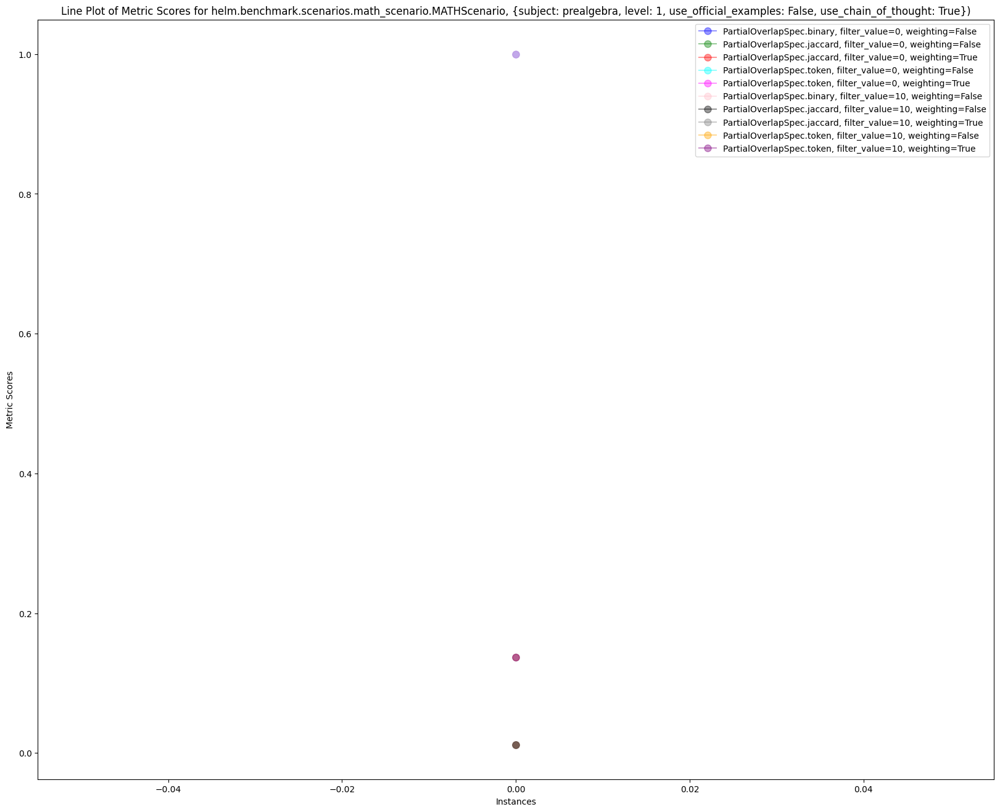

In [78]:
def visualize_metrics_of_scenario_spec(scenario_spec, metric_scores):
    colors = ['blue', 'green', 'red', 'cyan', 'magenta', 'pink', 'black', 'gray', 'orange', 'purple']

    # Create a line plot
    plt.figure(figsize=(20, 16))  # Adjust the figure size as needed
    lines = []  # To collect line objects for legend
    for index, (metric, scores) in enumerate(metric_scores.items()):
        label = metric_to_label(metric)  # Assuming you have a function 'metric_to_label' to get the label for a given metric
        line, = plt.plot(range(len(scores)), scores, marker='o', markersize=8, linestyle='-', color=colors[index], alpha=0.4, label=label)
        lines.append(line)

        # Annotate the offset of each line with the label
#         offset = int(random.random() * len(scores))
#         end_x = len(scores) - offset
#         end_y = scores[-offset]
#         plt.annotate(label, (end_x, end_y), textcoords="offset points", xytext=(5,0), ha='center')

    plt.xlabel('Instances')
    plt.ylabel('Metric Scores')
    plt.title(f'Line Plot of Metric Scores for {scenario_spec_to_str(scenario_spec)}')
    plt.grid(False)
#     plt.xticks([])  # This removes all x-axis ticks

    # Create the legend using the collected lines
    plt.legend(handles=lines, loc='best')
    
    plt.savefig(f'scatter_plots/{scenario_spec_to_str(scenario_spec)}.jpg')

    plt.show()

visualize_metrics_of_scenario_spec(scenario_spec, metric_scores)

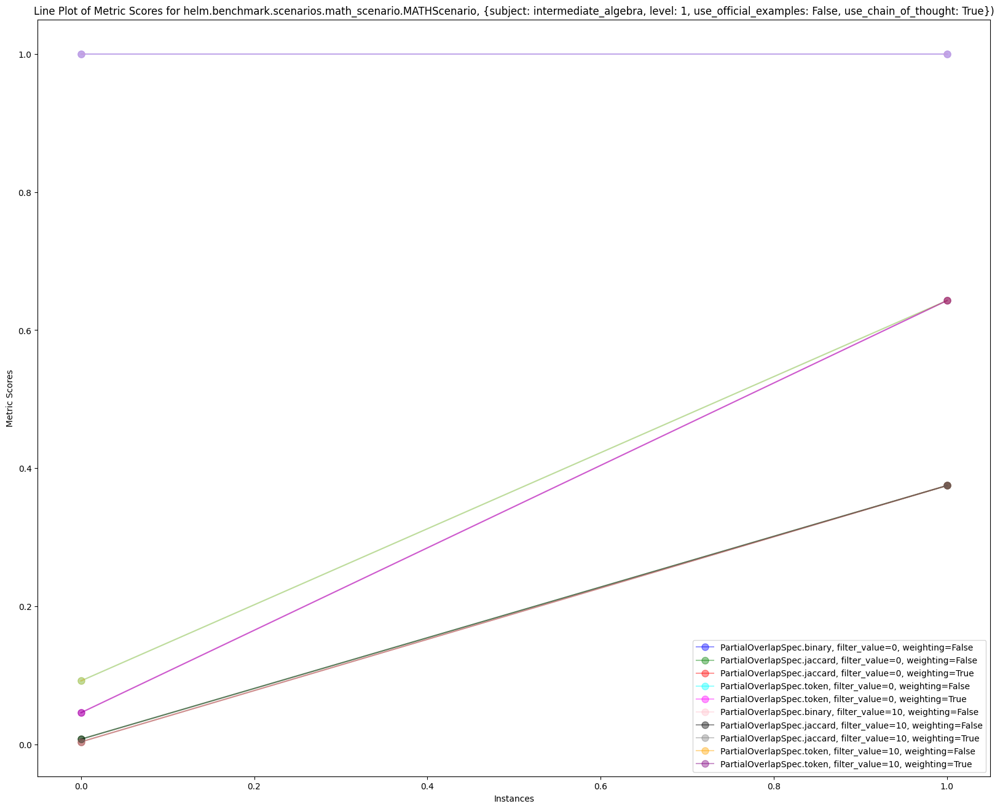

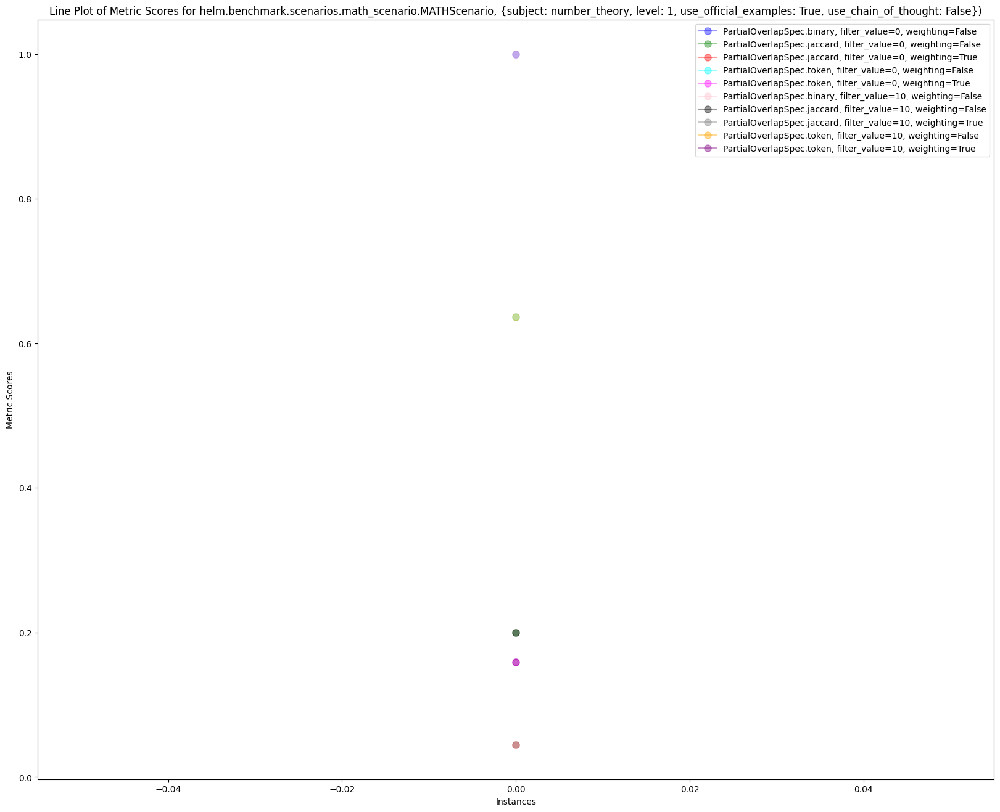

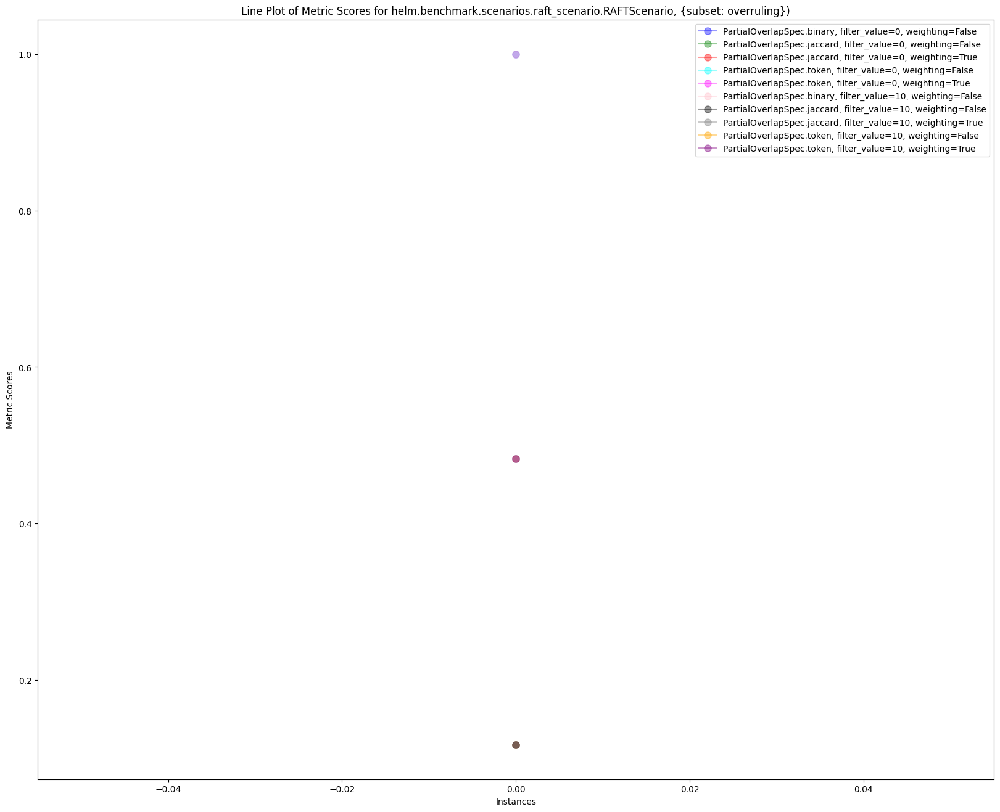

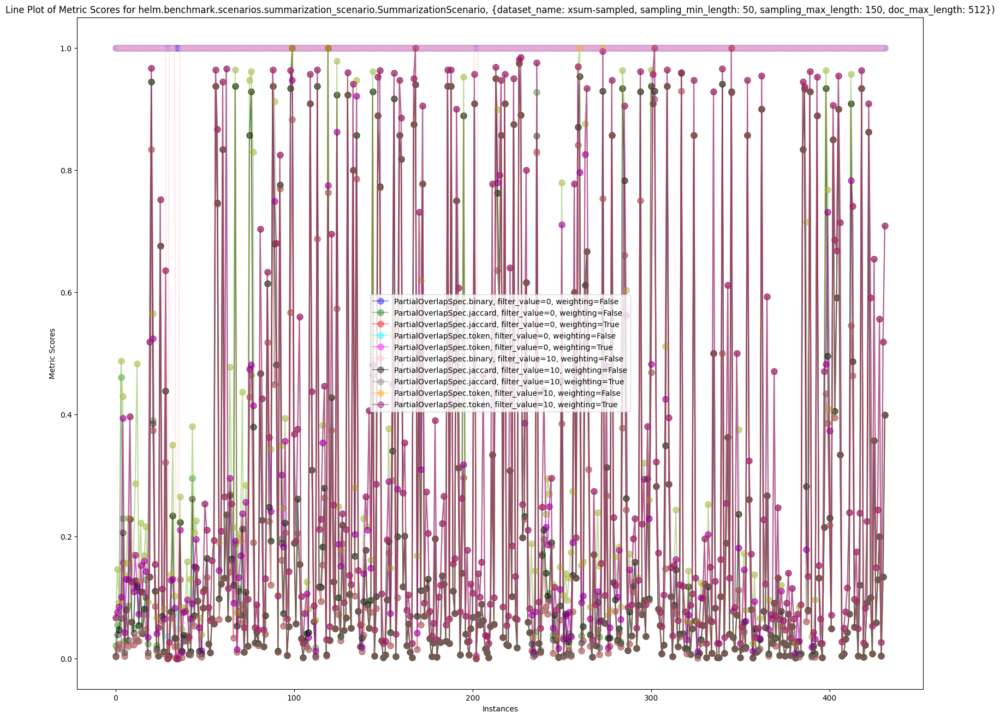

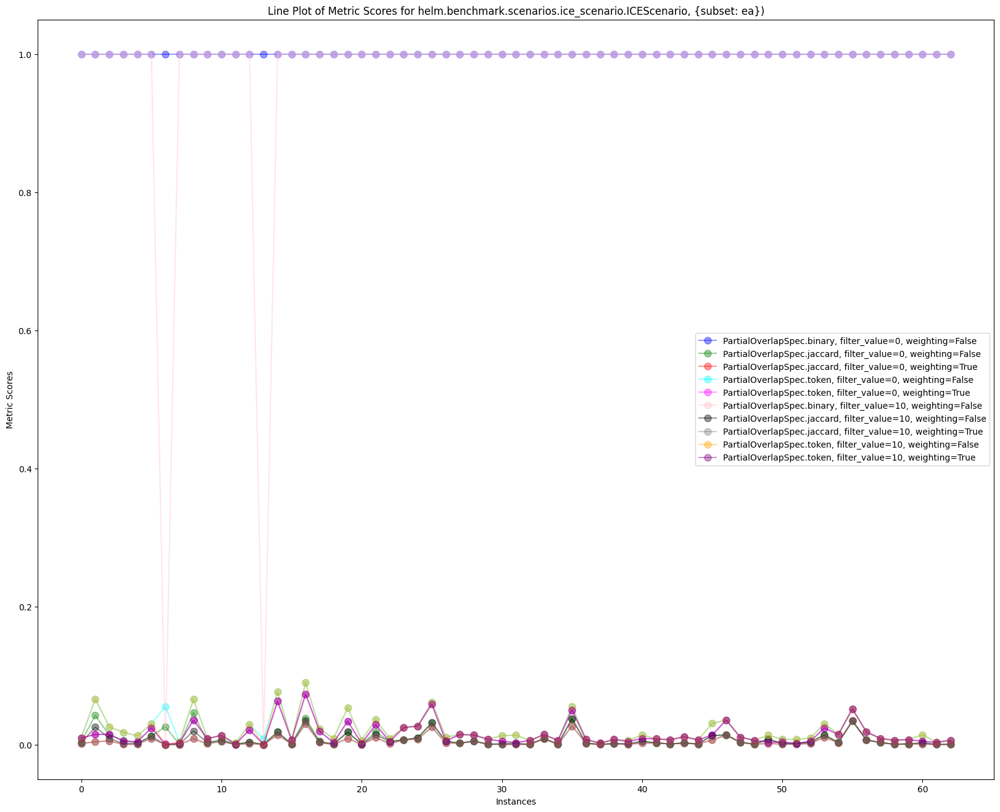

...

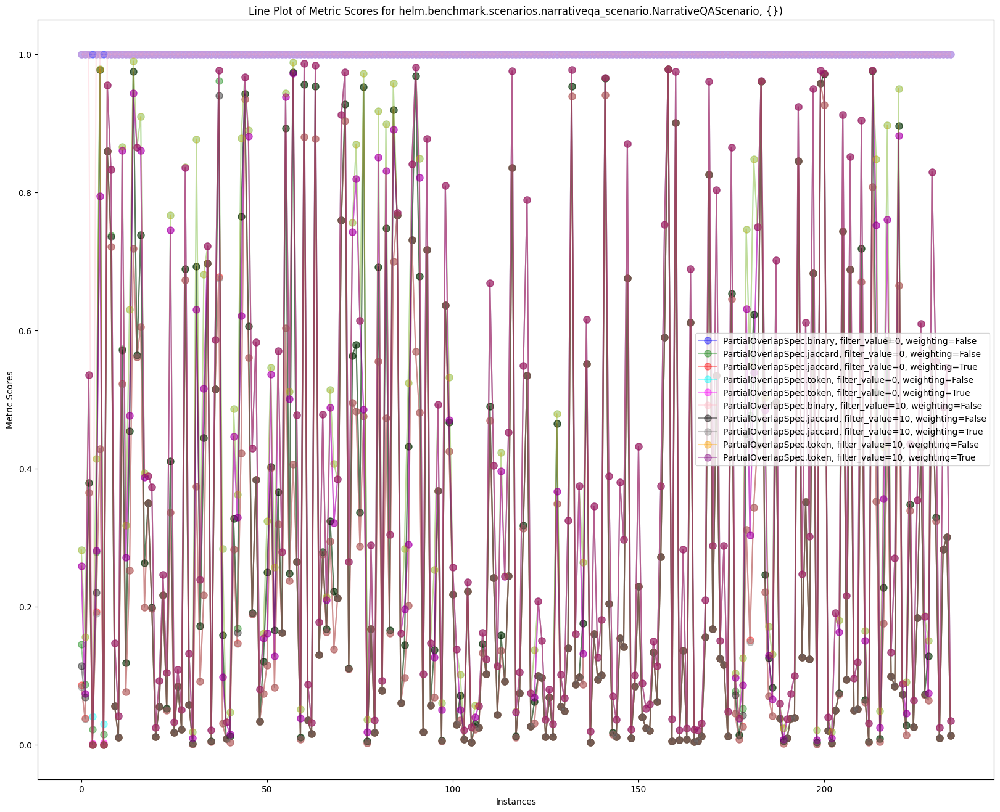

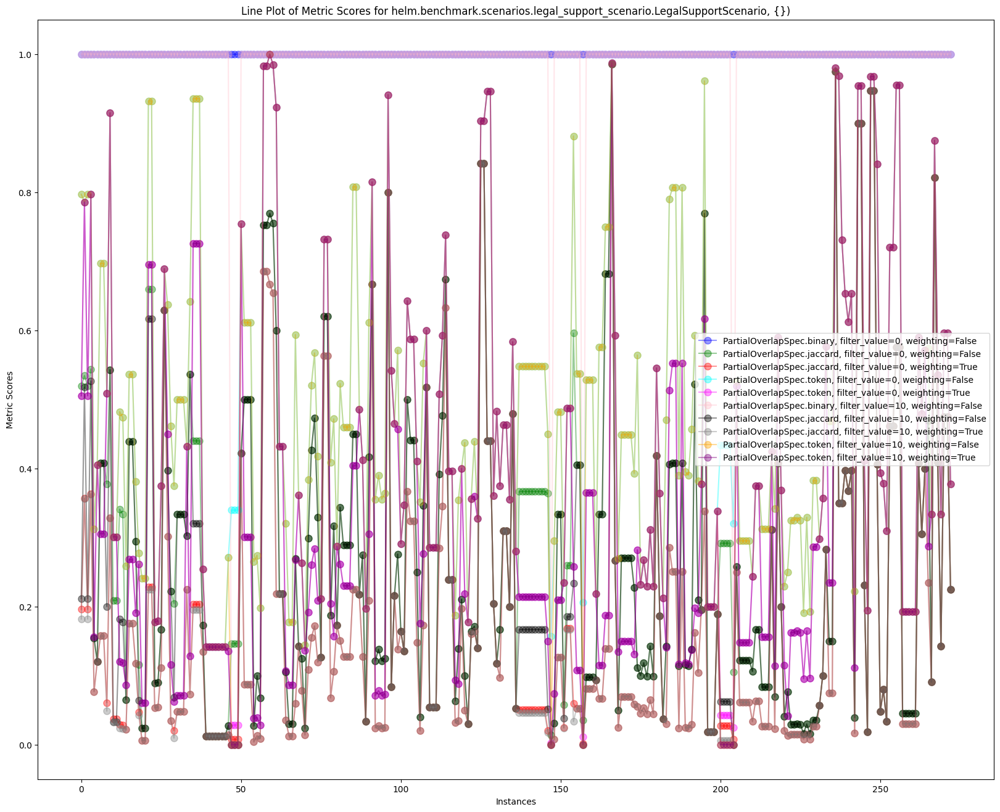

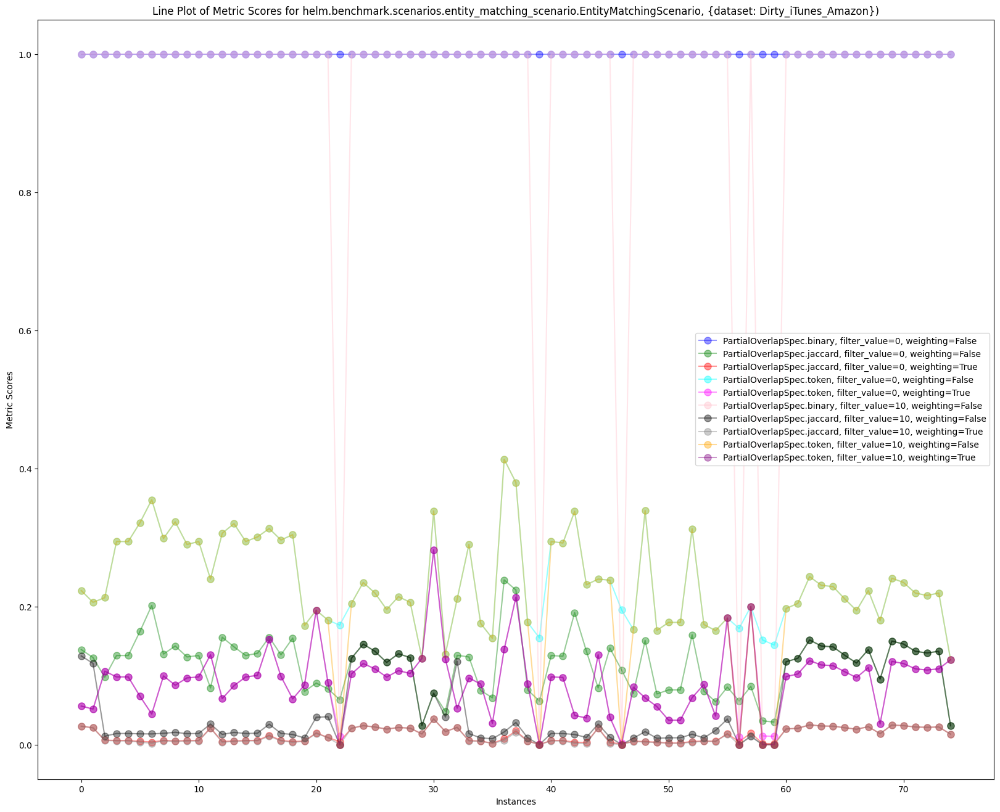

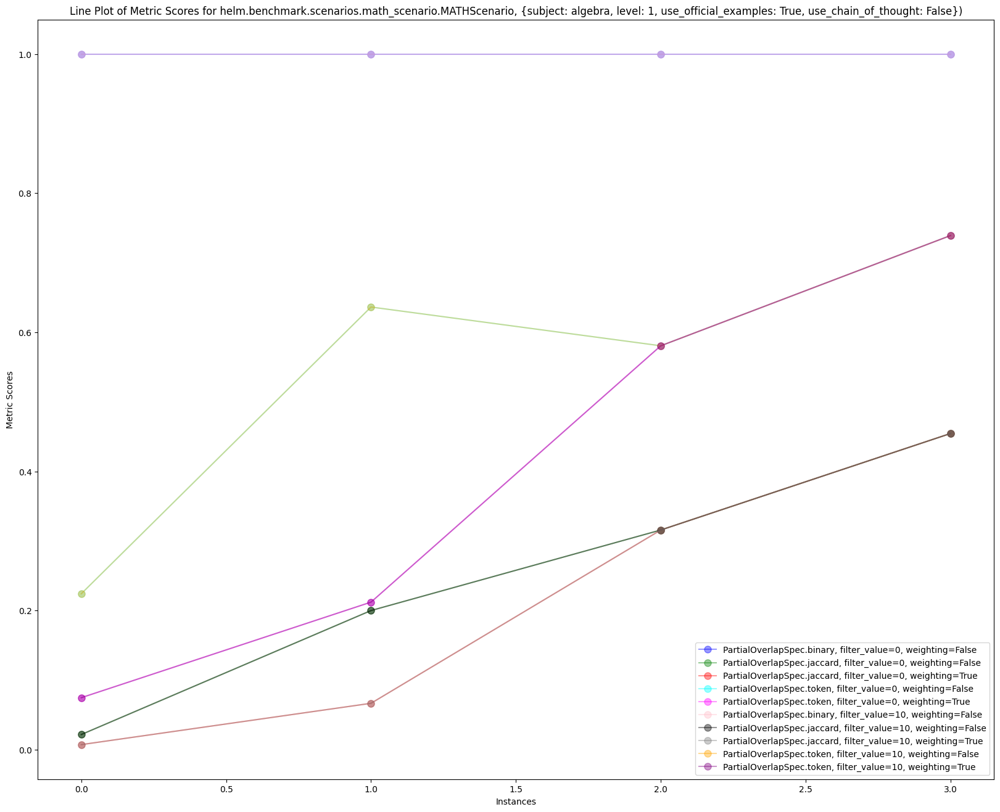

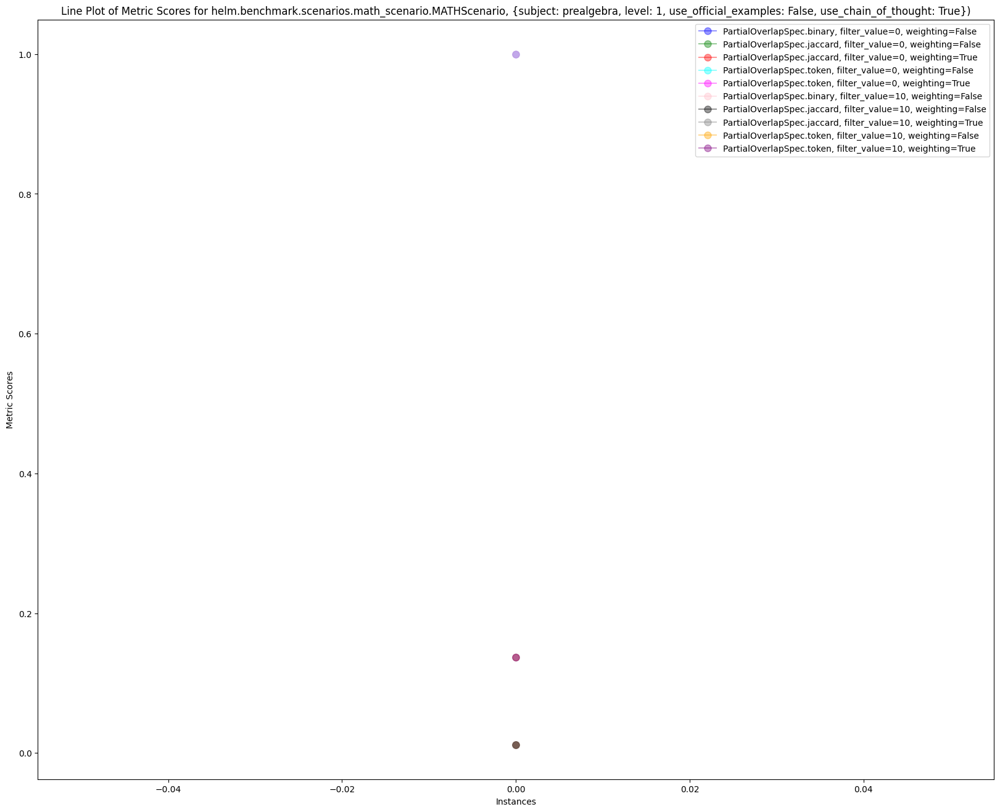

In [79]:
for scenario_spec, metric_scores in score_dict.items():
    visualize_metrics_of_scenario_spec(scenario_spec, metric_scores)
    